# Import libraries and data

In [1]:
# import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
from sklearn import preprocessing
import seaborn as sns

In [2]:
# import data
# datalink: 'https://raw.githubusercontent.com/elabrodsky/tulanemba/main/heart_2020_cleaned.csv'
datalink = 'https://raw.githubusercontent.com/elabrodsky/tulanemba/main/heart_2020_cleaned.csv'
df = pd.read_table(datalink, sep=',', header=(0))

df.head()

,HeartDisease,BMI,Smoking,AlcoholDrinking,Stroke,PhysicalHealth,MentalHealth,DiffWalking,Sex,AgeCategory,Race,Diabetic,PhysicalActivity,GenHealth,SleepTime,Asthma,KidneyDisease,SkinCancer
0,No,16.60,Yes,No,No,3.0,30.0,No,Female,55-59,White,Yes,Yes,Very good,5.0,Yes,No,Yes
1,No,20.34,No,No,Yes,0.0,0.0,No,Female,80 or older,White,No,Yes,Very good,7.0,No,No,No
2,No,26.58,Yes,No,No,20.0,30.0,No,Male,65-69,White,Yes,Yes,Fair,8.0,Yes,No,No
3,No,24.21,No,No,No,0.0,0.0,No,Female,75-79,White,No,No,Good,6.0,No,No,Yes
4,No,23.71,No,No,No,28.0,0.0,Yes,Female,40-44,White,No,Yes,Very good,8.0,No,No,No


# Convert the Yes/No fields into a numerical value by counting them:
(Columns: HeartDisease, Smoking, AlcoholDrinking, Stroke, DiffWalking, Diabetic, PhysicalActivity, Asthma, KidneyDisease, SkinCancer)


In [3]:
cat_num = pd.DataFrame()
cat_num['HeartDisease'] = pd.DataFrame(df['HeartDisease'].value_counts()/df['HeartDisease'].value_counts().sum())
cat_num['Smoking'] = pd.DataFrame(df['Smoking'].value_counts()/df['Smoking'].value_counts().sum())
cat_num['AlcoholDrinking'] = pd.DataFrame(df['AlcoholDrinking'].value_counts()/df['AlcoholDrinking'].value_counts().sum())
cat_num['Stroke'] = pd.DataFrame(df['Stroke'].value_counts()/df['Stroke'].value_counts().sum())

cat_num.style.format('{:.1%}')

,HeartDisease,Smoking,AlcoholDrinking,Stroke
No,91.4%,58.8%,93.2%,96.2%
Yes,8.6%,41.2%,6.8%,3.8%


In [4]:
# Statistics about Heart Diease between having Smoking history and no Smoking history
df[df['HeartDisease'] == "Yes"]['Smoking'].value_counts()/df[df['HeartDisease'] == "Yes"]['Smoking'].value_counts().sum()

Yes    0.585869
No     0.414131
Name: Smoking, dtype: float64

# Visualize the above data into a PIE CHART

### Option 1: using the newly created DataFrame cat_num

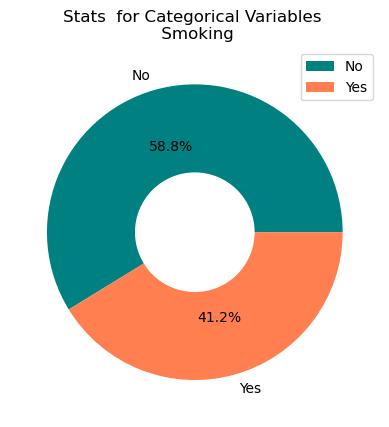

In [5]:
# matplotlib

my_circle = plt.Circle((0,0), 0.4, color='white')

plt.pie(cat_num['Smoking'], labels=cat_num.index, autopct='%1.1f%%', colors=['Teal', 'Coral'])
p = plt.gcf()
p.gca().add_artist(my_circle)
plt.title('Stats  for Categorical Variables \n Smoking')
plt.legend()
plt.show()

In [6]:
# plotly.express
## Pie chart/Donut chart
fig = px.pie(values=cat_num['Smoking'], names=cat_num.index, hole = 0.5, 
            color_discrete_sequence=px.colors.qualitative.Dark2)

fig.update_layout(
    title_text="Stats for Categorical Variables",
    # Add annotations in the center of the donut pies.
    annotations=[dict(text='Smoking', x=0.5, y=0.5, font_size=15, showarrow=False)])

## Plot size
fig.update_layout(height=400, width=400)
fig.show()

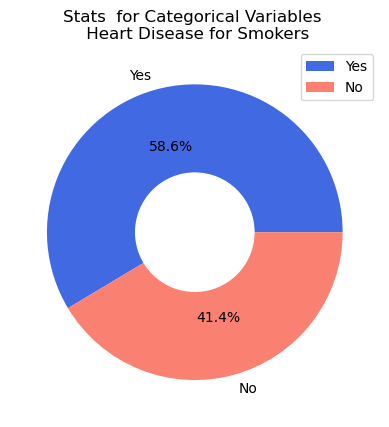

Yes    16037
No     11336
Name: Smoking, dtype: int64


In [7]:
### Option 2: using the original data df 
val = df[df['HeartDisease'] == "Yes"]['Smoking'].value_counts()
lbl = df[df['HeartDisease'] == "Yes"]['Smoking'].unique().tolist()
my_circle = plt.Circle((0,0), 0.4, color='white')

plt.pie(val, labels=lbl, autopct='%1.1f%%', colors=['RoyalBlue', 'Salmon'],radius=1)
p = plt.gcf()
p.gca().add_artist(my_circle)
plt.title('Stats  for Categorical Variables \n Heart Disease for Smokers')
plt.legend()
plt.show()
print(val)

In [8]:
## Pie chart/Donut chart
fig = px.pie(values=(df[df['HeartDisease'] == "Yes"]['Smoking'].value_counts()/df[df['HeartDisease'] == "Yes"]['Smoking'].value_counts().sum()), 
            names=lbl, hole = 0.5)

fig.update_layout(
    title_text="Stats for Categorical Variables",
    # Add annotations in the center of the donut pies.
    annotations=[dict(text='Heart Disease for Smokers', x=0.5, y=0.5, font_size=15, showarrow=False)])

## Plot size
fig.update_layout(height=400, width=400)
fig.show()

In [9]:
# Combine

import plotly.graph_objects as go 
from plotly.subplots import make_subplots

val_Smoking = cat_num['Smoking']
val_AlcoholDrinking = cat_num['AlcoholDrinking']
val_Stroke = cat_num['Stroke']
lbl = cat_num.index

# create subplots: use 'domain' type for Pie subplot
fig = make_subplots(rows = 1, cols=3, specs=[[{'type':'domain'}, {'type':'domain'}, {'type':'domain'}]])

# create our pie charts
fig.add_trace(go.Pie(labels=lbl, values=val_Smoking, name='Smoking'),1,1)
fig.add_trace(go.Pie(labels=lbl, values=val_AlcoholDrinking, name='Alcohol Drinking'), 1,2)
fig.add_trace(go.Pie(labels=lbl, values=val_Stroke, name='Stroke'), 1,3)

# use 'hole' to create a donut-like pie chart
fig.update_traces(hole=0.5, hoverinfo='label+percent+name')

fig.update_layout(
    title = 'Stats for Categorical Variables',
    # Add annotations in the center of the donut pies.
    annotations=[dict(text='Smoking', x=0.1, y=0.5, font_size=15, showarrow=False),
                dict(text='Alcohol Drinking', x=0.5, y=0.5, font_size=15, showarrow=False),
                dict(text='Stroke', x=0.89, y=0.5, font_size=15, showarrow=False)]
)
fig.show()

# Convert all the fields/ features to numerical data type:

In [10]:
df_num = df
df_num['AgeCategory']

0               55-59
1         80 or older
2               65-69
3               75-79
4               40-44
             ...     
319790          60-64
319791          35-39
319792          45-49
319793          25-29
319794    80 or older
Name: AgeCategory, Length: 319795, dtype: object

In [11]:
# ## define AGE CATEGORY for user-defined coding
encode_AgeCategory = {'18-24':21, '25-29':27, 
                    '30-34':32, '35-39':37,
                    '40-44':42, '45-49':47,
                    '50-54':52, '55-59':57,
                    '60-64':62, '65-69':67,
                    '70-74':72, '75-79':77, '80 or older': 80}

## encode age cateogry into respective numbers
df_num['AgeCategory'] = df_num['AgeCategory'].apply(lambda x: encode_AgeCategory[x])

## convert data into floats:
df_num['AgeCategory'] = df_num['AgeCategory'].astype('float')

## define GENHEALTH CATEGORY for user-defined encoding
encode_GenHealth = {'Poor':0, 'Fair':1, 'Good':2, 'Very good':3, 'Excellent':4}

## encode age cateogry into respective numbers
df_num['GenHealth'] = df_num['GenHealth'].apply(lambda x: encode_GenHealth[x])

## convert data into floats:
df_num['GenHealth'] = df_num['GenHealth'].astype('float')

# Integer encode columns with 2 unique values:
for col in ['Smoking', 'AlcoholDrinking', 'Stroke', 'DiffWalking', 'Sex', 'PhysicalActivity', 'Asthma', 'KidneyDisease', 'SkinCancer']:
    if df[col].dtype == 'O':     ### select only columns with object datatype
        le = preprocessing.LabelEncoder()
        df_num[col] = le.fit_transform(df[col])

## One-hot encode columns with more than 2 unique values
## This will create multiple columns for Race with defined prefix
df_num = pd.get_dummies(df, columns=['Race', 'Diabetic'], prefix = ['Race', 'Diabetic'])

## Display the dataframe
df_num.head()

,HeartDisease,BMI,Smoking,AlcoholDrinking,Stroke,PhysicalHealth,MentalHealth,DiffWalking,Sex,AgeCategory,...,Race_American Indian/Alaskan Native,Race_Asian,Race_Black,Race_Hispanic,Race_Other,Race_White,Diabetic_No,"Diabetic_No, borderline diabetes",Diabetic_Yes,Diabetic_Yes (during pregnancy)
0,No,16.60,1,0,0,3.0,30.0,0,0,57.0,...,0,0,0,0,0,1,0,0,1,0
1,No,20.34,0,0,1,0.0,0.0,0,0,80.0,...,0,0,0,0,0,1,1,0,0,0
2,No,26.58,1,0,0,20.0,30.0,0,1,67.0,...,0,0,0,0,0,1,0,0,1,0
3,No,24.21,0,0,0,0.0,0.0,0,0,77.0,...,0,0,0,0,0,1,1,0,0,0
4,No,23.71,0,0,0,28.0,0.0,1,0,42.0,...,0,0,0,0,0,1,1,0,0,0


In [12]:
df['Race'].unique()

array(['White', 'Black', 'Asian', 'American Indian/Alaskan Native',
       'Other', 'Hispanic'], dtype=object)

In [13]:
pd.get_dummies(df['Race']).head()

,American Indian/Alaskan Native,Asian,Black,Hispanic,Other,White
0,0,0,0,0,0,1
1,0,0,0,0,0,1
2,0,0,0,0,0,1
3,0,0,0,0,0,1
4,0,0,0,0,0,1


## Heatmap

### Seaborn

In [14]:
# duplicate to another dataframe
df_num1 = df_num
# encode the Heart Disease column as well
df_num1['HeartDisease'] = df_num1['HeartDisease'].map(dict(Yes=1, No=0))

<AxesSubplot: >

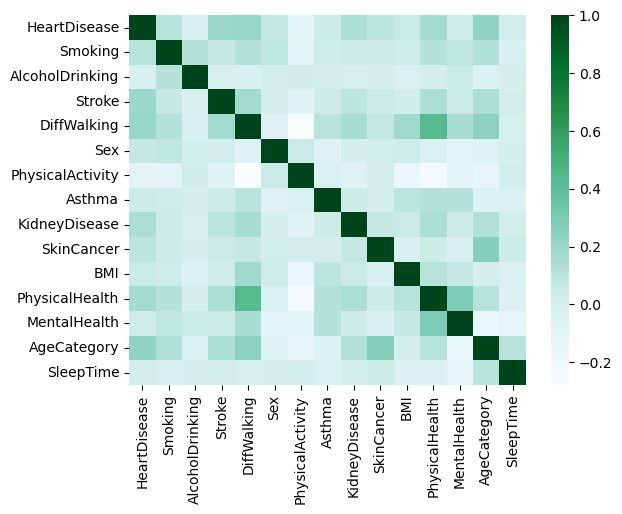

In [15]:
sns.heatmap(df_num1[['HeartDisease', 'Smoking', 'AlcoholDrinking', 'Stroke', 'DiffWalking', 'Sex', 'PhysicalActivity', 'Asthma',
                    'KidneyDisease', 'SkinCancer', 'BMI', 'PhysicalHealth', 'MentalHealth', 'AgeCategory', 'SleepTime']].corr(),
            cmap = 'BuGn')

### With Plotly

In [16]:
# plotly.express

## Plot plotly heatmap with correlation coefficient values
fig = px.imshow(df_num1[['HeartDisease', 'Smoking', 'AlcoholDrinking', 'Stroke', 'DiffWalking', 'Sex',
                    'PhysicalActivity', 'Asthma', 'KidneyDisease', 'SkinCancer','BMI', 'PhysicalHealth',
                    'MentalHealth', 'AgeCategory', 'SleepTime']].corr(),color_continuous_scale="Greens")
## Plot size
fig.update_layout(height=600)
fig.show()

# Principle Component Analysis
perform PCA for visual exploration of all data

### Visualization with Plotly

In [17]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# scale and center the data
scaled = StandardScaler()
### shorter version: scaled_data = scaled.fit_transform(df_num1)
scaled.fit(df_num1)
scaled_data = scaled.transform(df_num1)

# run Principal Component Analysis
pca = PCA(n_components=3)
pca.fit(scaled_data)
xpca = pca.transform(scaled_data)

# define the variance explained format for the components 
PC1_label = "PC1 {}%".format(round((100*pca.explained_variance_ratio_[0]),2))
PC2_label = "PC2 {}%".format(round((100*pca.explained_variance_ratio_[1]),2))
PC3_label = "PC3 {}%".format((round(100*pca.explained_variance_ratio_[2]),2))

# create dataframe for PCA
df_pca = pd.DataFrame(xpca)
df_pca.columns = [PC1_label, PC2_label, PC3_label]

In [18]:
# Visualization with plotly
# 2D
figPCA = px.scatter(df_pca, x=PC1_label, y=PC2_label,
                    title="PCA 2D Plot", 
                    color=df.HeartDisease,
                    template = "plotly_white",
                    opacity=0.5,
                    height=600)
figPCA.update_traces(marker=dict(size=10, line=dict(width=2, color='Black')))
figPCA.show()

In [19]:
# 3D
figPCA_3D = px.scatter_3d(df_pca, x=PC1_label, y=PC2_label, z=PC3_label,
                        title='PCA 3D Plot',
                        color=df.HeartDisease,
                        template='plotly_white',
                        height=600)
figPCA_3D.update_traces(marker=dict(size=10, line=dict(width=2, color='Black')))
figPCA_3D.show()

### Visualization with matplotliby.pyplot and seaborn

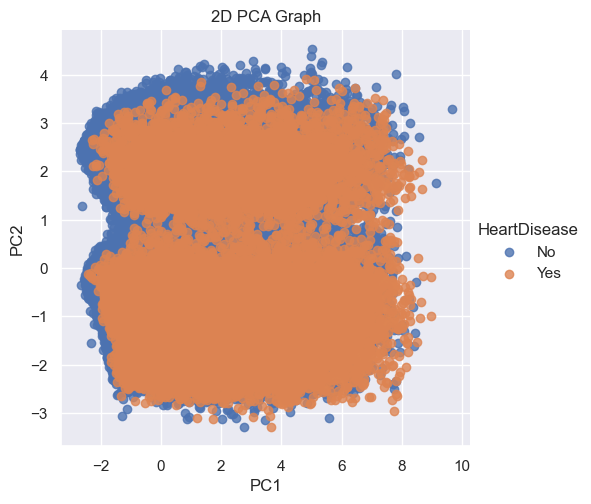

In [20]:
# 2D
import matplotlib.pyplot as plt 
import seaborn as sns

# Reduce from 4 to 2 features with PCA
pca_2D = PCA(n_components=2)
 
# Fit and transform data
X = df_num1.loc[:, df_num1.columns != 'HeartDisease']
y = df['HeartDisease']

X_scaled = StandardScaler().fit_transform(X)
pca_features_2D = pca_2D.fit_transform(X_scaled)
 
# Create dataframe
pca_df_2D = pd.DataFrame(
    data=pca_features_2D, 
    columns=['PC1', 'PC2'])
 
 
pca_df_2D['HeartDisease'] = y
 
#pca_df_2D.head()
sns.set()
 
sns.lmplot(
    x='PC1', 
    y='PC2', 
    data=pca_df_2D, 
    hue='HeartDisease', 
    fit_reg=False, 
    legend=True
    )
plt.title('2D PCA Graph')
plt.show()

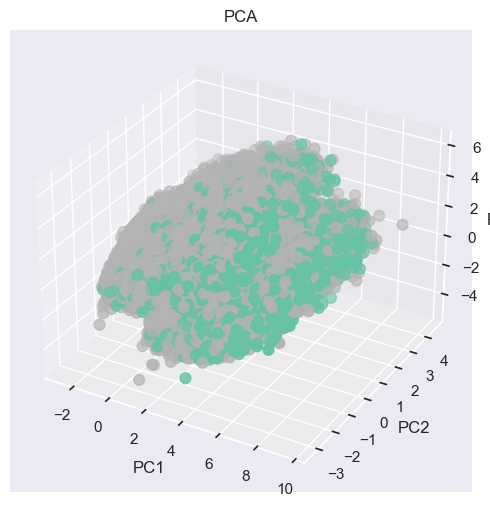

In [21]:
# 3D
# Reduce from 4 to 2 features with PCA
pca_3D = PCA(n_components=3)

# Fit and transform data
X = df_num1.loc[:, df_num1.columns != 'HeartDisease']
y = df['HeartDisease']

X_scaled = StandardScaler().fit_transform(X)
pca_features_3D = pca_3D.fit_transform(X_scaled)

results_3D = pd.DataFrame(pca_features_3D, columns=['PCA%i' % i for i in range(1,4)], index=df_num1.index)

# Plot initialisation
#my_color=df['HeartDisease'].cat.codes

fig = plt.figure(figsize=(8,6))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(results_3D['PCA1'], results_3D['PCA2'], results_3D['PCA3'], 
            c=df_num1['HeartDisease'], cmap="Set2_r", s=60)
 
# make simple, bare axis lines through space:
#xAxisLine = ((min(results_3D['PCA1']), max(results_3D['PCA1'])), (0, 0), (0,0))
#ax.plot(xAxisLine[0], xAxisLine[1], xAxisLine[2], 'r')
#yAxisLine = ((0, 0), (min(results_3D['PCA2']), max(results_3D['PCA2'])), (0,0))
#ax.plot(yAxisLine[0], yAxisLine[1], yAxisLine[2], 'r')
#zAxisLine = ((0, 0), (0,0), (min(results_3D['PCA3']), max(results_3D['PCA3'])))
#ax.plot(zAxisLine[0], zAxisLine[1], zAxisLine[2], 'r')
 
# label the axes
ax.set_xlabel("PC1")
ax.set_ylabel("PC2")
ax.set_zlabel("PC3")
ax.set_title("PCA")
plt.show()